In [1]:
import numpy as np
import seaborn as sns
import os
import toyplot
import matplotlib.pyplot as plt
import pandas as pd
from dateutil import parser

In [2]:
%pwd

'/Users/patrickmckenzie/googledrive/projects/flower_color_phenology/notebooks'

In [3]:
%cd ..

/Users/patrickmckenzie/googledrive/projects/flower_color_phenology


In [4]:
inat_flowering = pd.read_csv('./manuscript/final_data/fulldata_cleaned_matched_GPT_colors.csv')

/var/folders/qh/c7rwx84921n2kznn09zb2pnh0000gn/T/ipykernel_27659/2078511110.py:1: DtypeWarning: Columns (14,29) have mixed types. Specify dtype option on import or set low_memory=False.
  inat_flowering = pd.read_csv('./manuscript/final_data/fulldata_cleaned_matched_GPT_colors.csv')


In [5]:
whiteyellow = ['white',
               #'yellow',
               #'green',
              ]
reds = [#'blue', 
         #'brown', 
         #'green', 
         #'orange', 
         #'pink', 
         #'purple', 
         'red',
         #'violet',
        #'blue',
         #
]

In [8]:
os.mkdir('./data/maxent/jan24outputs/maps/redwhite',)

/var/folders/qh/c7rwx84921n2kznn09zb2pnh0000gn/T/ipykernel_27659/923815250.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(ncols=2,nrows=1, gridspec_kw=dict(width_ratios=[1,1]),figsize=(20,6))


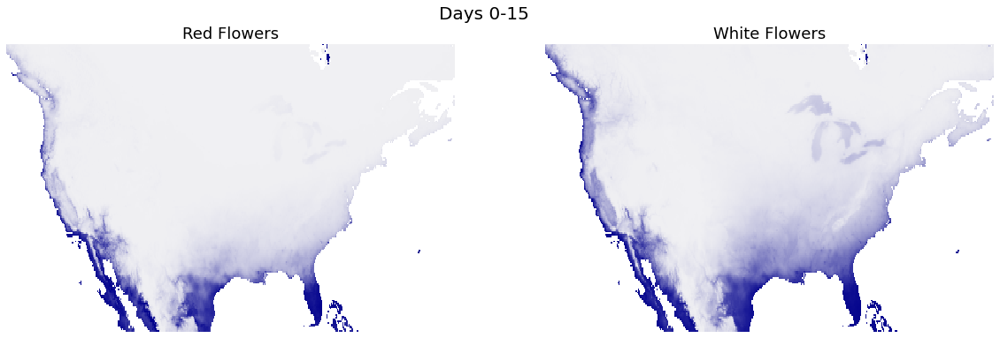

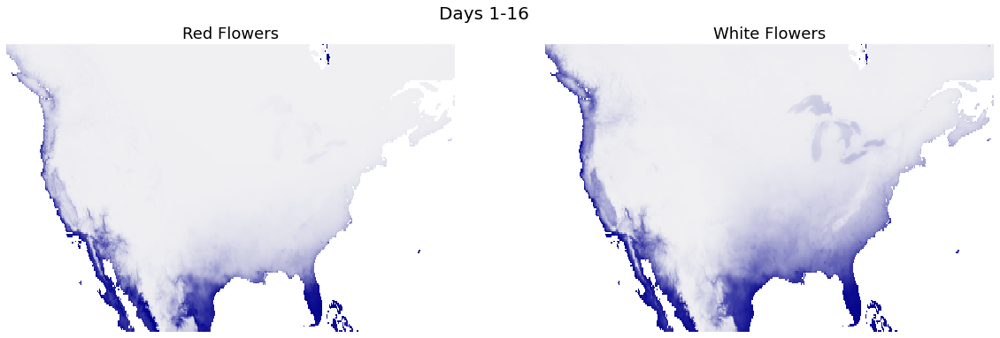

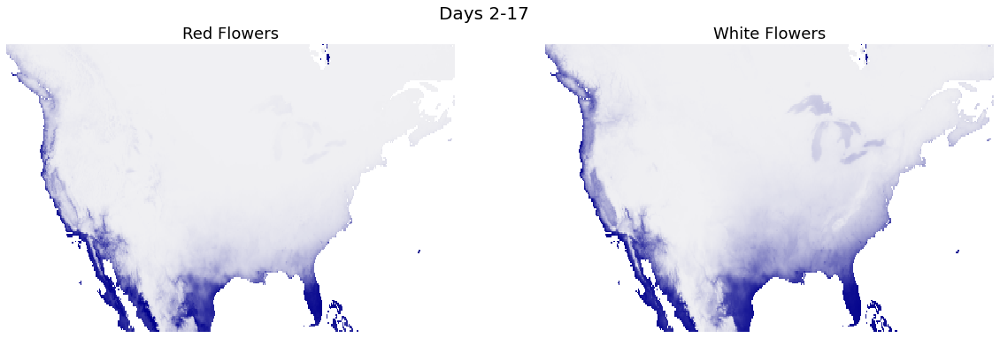

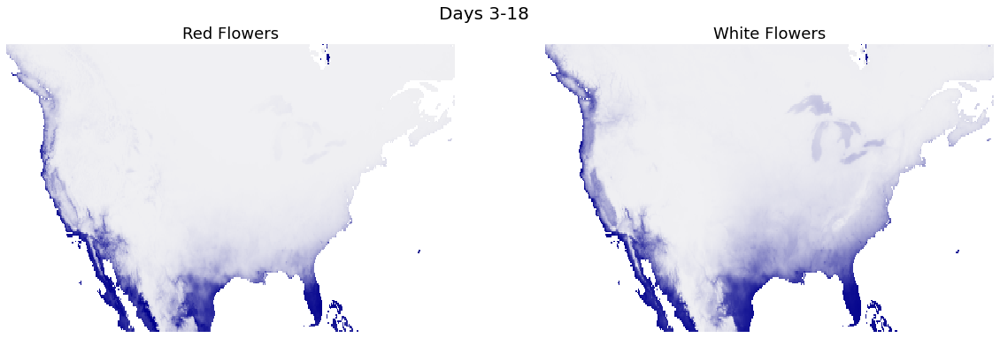

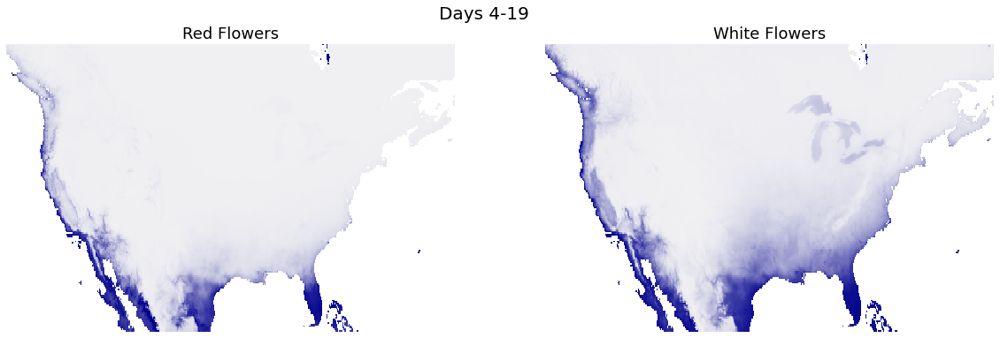

...

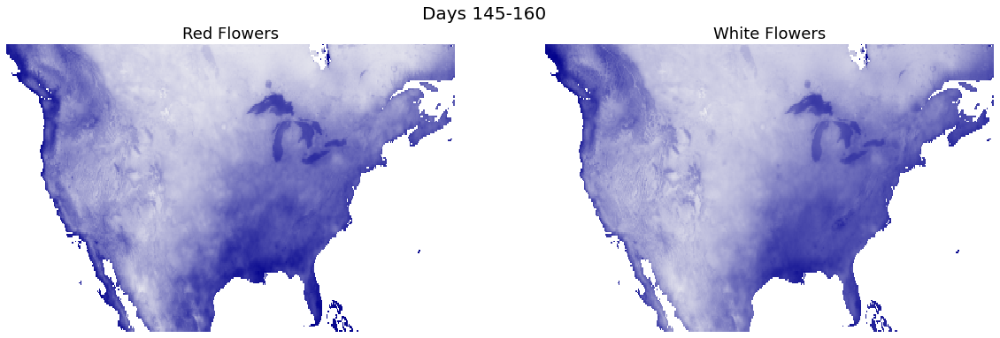

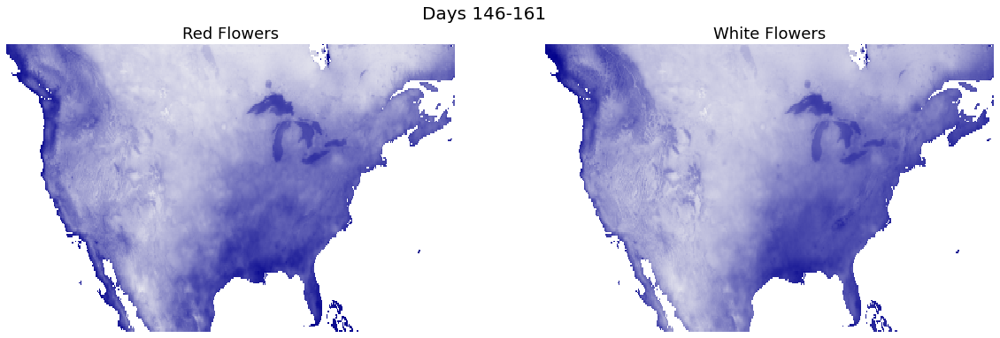

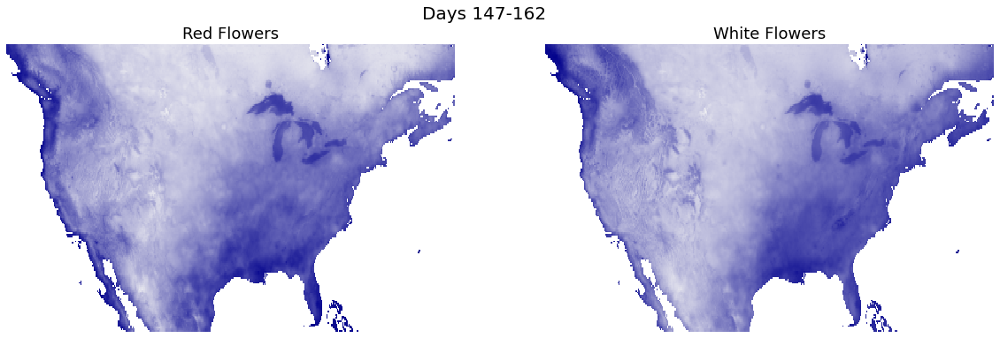

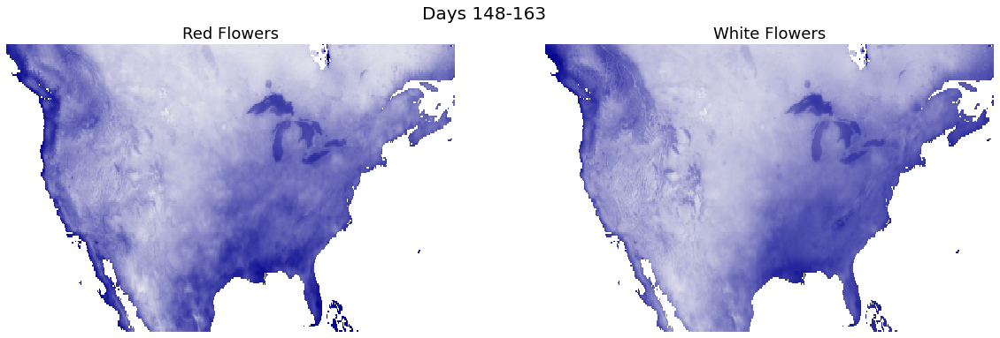

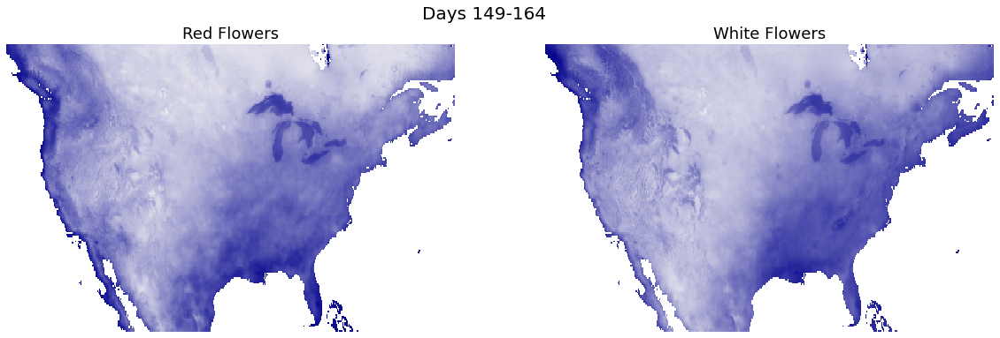

In [12]:
#starter_val = 85
for starter_val in range(0,150):
    # save raster output from maxent
    density_mat_red = np.genfromtxt(os.path.join('./data/maxent/jan24outputs/red_flowers_troch_bombus_environ_overall',
                                                  'red'+'_'+str(starter_val)+".asc"),
                                     delimiter=' ',
                                     skip_header=6)
    # remove the nans (maxent saves these as -9999)
    density_mat_red[density_mat_red == -9999] = np.nan

    # save raster output from maxent
    density_mat_white = np.genfromtxt(os.path.join('./data/maxent/jan24outputs/white_flowers_troch_bombus_environ_overall',
                                                  'white'+'_'+str(starter_val)+".asc"),
                                     delimiter=' ',
                                     skip_header=6)
    # remove the nans (maxent saves these as -9999)
    density_mat_white[density_mat_white == -9999] = np.nan

    fig, axs = plt.subplots(ncols=2,nrows=1, gridspec_kw=dict(width_ratios=[1,1]),figsize=(20,6))
    fig.suptitle('Days ' + str(starter_val) + '-' + str(starter_val+15),fontsize=20)
    sns.heatmap(density_mat_red, ax=axs[0],cbar=False,xticklabels=False,yticklabels=False,cmap=sns.color_palette("light:darkblue", as_cmap=True)).set_title('Red Flowers',fontsize=18);
    sns.heatmap(density_mat_white, ax=axs[1],cbar=False,xticklabels=False,yticklabels=False,cmap=sns.color_palette("light:darkblue", as_cmap=True)).set_title('White Flowers',fontsize=18);

    plt.savefig('./data/maxent/jan24outputs/maps/redwhite'+'/red_white'+str(starter_val)+'.png')

In [11]:
import imageio

filenames = ['./data/maxent/jan24outputs/maps/redwhite/'+'red_white'+str(i) +'.png' for i in range(0,150)]

with imageio.get_writer('./jan24red_white.gif', mode='I',duration=0.1) as writer:
    for filename in filenames:
        image = imageio.imread(filename)
        writer.append_data(image)

/var/folders/qh/c7rwx84921n2kznn09zb2pnh0000gn/T/ipykernel_27659/1597675907.py:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning dissapear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)
